In [5]:
classes = ['MEL', 'NV', 'BCC', 'AK', 'BKL', 'DF', 'VASC', 'SCC', 'UNK']

Wrong predicted images with ground truth MEL class:


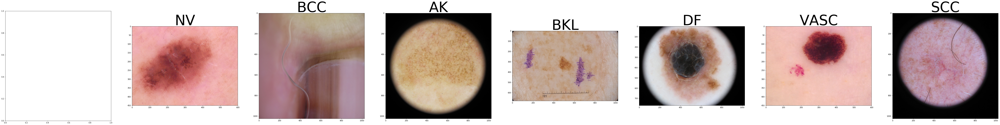

Wrong predicted images with ground truth NV class:


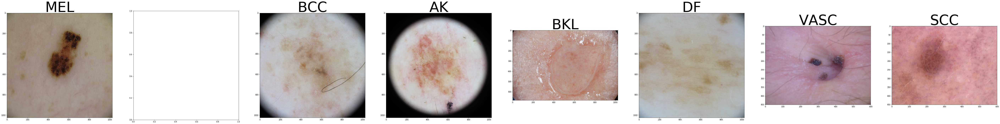

Wrong predicted images with ground truth BCC class:


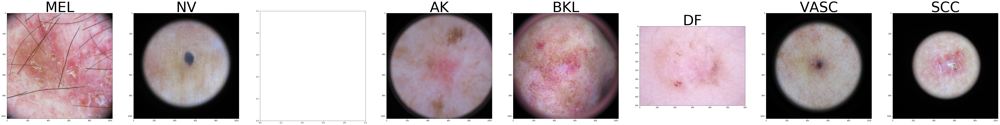

Wrong predicted images with ground truth AK class:


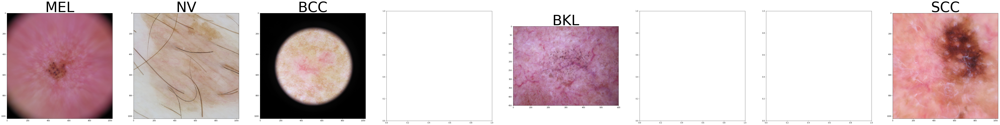

Wrong predicted images with ground truth BKL class:


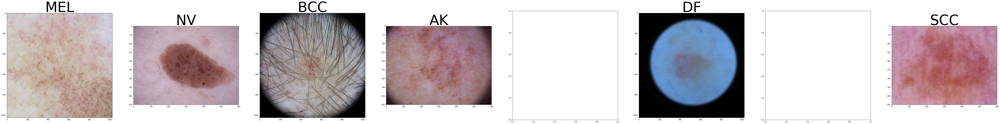

Wrong predicted images with ground truth DF class:


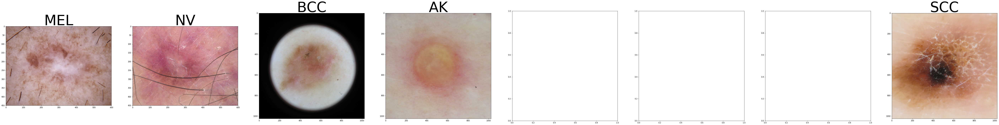

Wrong predicted images with ground truth VASC class:


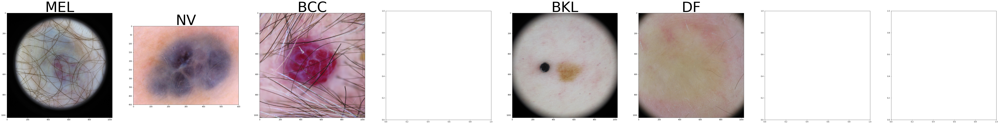

Wrong predicted images with ground truth SCC class:


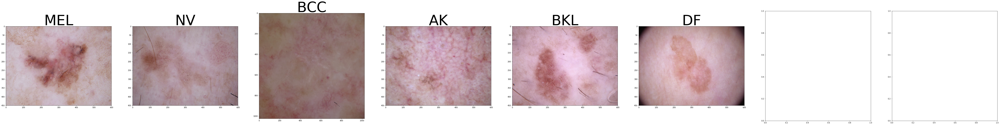

In [45]:
import pandas as pd

error_instances = pd.read_csv('logs/isic2019_densenet121.error')
class_number = 8

for class_label in range(8):
    print("Wrong predicted images with ground truth %s class:" % classes[class_label])
    
    error_instances_per_class = error_instances[error_instances['label'] == class_label]

    images, predictions = [], []
    for class_prediction in range(8):
        instances = error_instances_per_class[error_instances_per_class['prediction'] == class_prediction]

        if len(instances) > 0:
            instance = instances.sample(n=1, random_state=1)

            images.append(mpimg.imread(instance.iloc[0]['image']))
            predictions.append(instance.iloc[0]['prediction'])
        
        else:
            images.append(None)
            predictions.append(None)
    
    plt.figure(figsize=(100, 25))
    for i, (image, prediction) in enumerate(zip(images, predictions)):
        if prediction is not None:
            plt.subplot(len(images) / class_number + 1, class_number, i + 1).set_title(classes[prediction], fontsize=80)
        else:
            plt.subplot(len(images) / class_number + 1, class_number, i + 1)
            
        if image is not None:
            plt.imshow(image)
    
    plt.show(block=False)